In [ ]:
# Mount the Google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install adversarial-robustness-toolbox

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 33.4 MB/s eta 0:00:00


# Here, we load the Bean Leaf dataset used for training and testing the classifier. We also preprocess the images—such as resizing and normalization—to make them compatible with the model input.

In [ ]:
import os
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers, models
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import random
import pandas as pd
from IPython.display import display

In [ ]:
# 2. Set Paths
train_dir = '/content/drive/MyDrive/train.zip'
val_dir = '/content/drive/MyDrive/validation.zip'
test_dir = '/content/drive/MyDrive/test.zip'

In [ ]:
# 3. Set Parameters
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
NUM_CLASSES = 3

In [ ]:
# 1. Unzip the files
import zipfile

# Unzip train.zip
with zipfile.ZipFile('/content/drive/MyDrive/train.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/beans_dataset/train')

# Unzip validation.zip
with zipfile.ZipFile('/content/drive/MyDrive/validation.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/beans_dataset/validation')

# Unzip test.zip
with zipfile.ZipFile('/content/drive/MyDrive/test.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/beans_dataset/test')



In [ ]:
# Correct paths
train_dir = '/content/beans_dataset/train/train'
val_dir = '/content/beans_dataset/validation/validation'
test_dir = '/content/beans_dataset/test/test'


In [ ]:
# Load Datasets
ds_train = tf.keras.preprocessing.image_dataset_from_directory(
    train_dir,
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    label_mode='int'
)

ds_val = tf.keras.preprocessing.image_dataset_from_directory(
    val_dir,
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    label_mode='int'
)

ds_test = tf.keras.preprocessing.image_dataset_from_directory(
    test_dir,
    image_size=IMG_SIZE,
    batch_size=50,
    label_mode='int'
)


Found 1034 files belonging to 3 classes.
Found 133 files belonging to 3 classes.
Found 128 files belonging to 3 classes.


In [ ]:
class_names = ds_train.class_names
print("Class names:", class_names)

Class names: ['angular_leaf_spot', 'bean_rust', 'healthy']


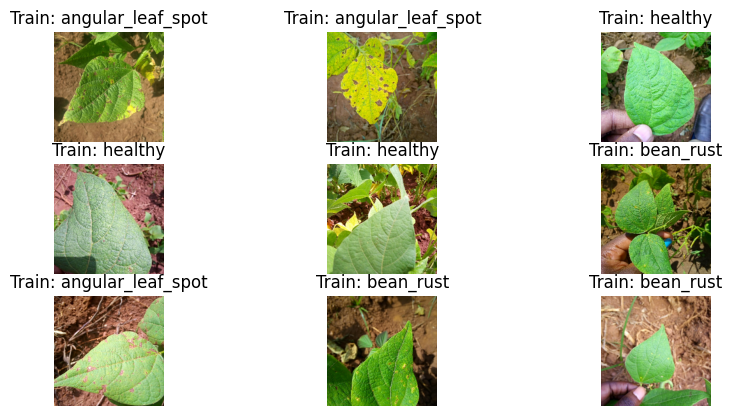

In [ ]:
# Plot images from both train and validation sets
plt.figure(figsize=(10, 10))

# Plot 9 images from train dataset
for images, labels in ds_train.take(1):
    for i in range(9):
        ax = plt.subplot(6, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(f"Train: {class_names[labels[i].numpy()]}")
        plt.axis("off")

In [ ]:
# 5. Prefetch for Performance
AUTOTUNE = tf.data.AUTOTUNE
ds_train = ds_train.prefetch(buffer_size=AUTOTUNE)
ds_val = ds_val.prefetch(buffer_size=AUTOTUNE)


# We construct a convolutional neural network using the pre-trained ResNet50 architecture (without top layers) and add custom dense layers for classification. This forms our primary model for evaluation.

In [ ]:
base_model = tf.keras.applications.ResNet50(
    input_shape=(224, 224, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False  # Freeze base model


94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [ ]:
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(NUM_CLASSES, activation='softmax')
])

# The model is compiled with the Adam optimizer and trained using sparse categorical cross-entropy loss. Early stopping is used to prevent overfitting by monitoring the validation accuracy.

In [ ]:
model.compile(
    optimizer='adam',
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
# Define the number of epochs
EPOCHS = 30

# Train the model
history = model.fit(
    ds_train,
    validation_data=ds_val,
    epochs=EPOCHS
)



Epoch 1/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 28s 421ms/step - accuracy: 0.5209 - loss: 1.0140 - val_accuracy: 0.8195 - val_loss: 0.4767
Epoch 2/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 5s 133ms/step - accuracy: 0.8209 - loss: 0.4558 - val_accuracy: 0.8722 - val_loss: 0.3449
Epoch 3/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8960 - loss: 0.3212 - val_accuracy: 0.8872 - val_loss: 0.2886
Epoch 4/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9004 - loss: 0.2738 - val_accuracy: 0.9023 - val_loss: 0.2719
Epoch 5/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 6s 118ms/step - accuracy: 0.9237 - loss: 0.2352 - val_accuracy: 0.9173 - val_loss: 0.2439
Epoch 6/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 4s 103ms/step - accuracy: 0.9600 - loss: 0.1855 - val_accuracy: 0.9323 - val_loss: 0.2173
Epoch 7/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9623 - loss: 0.1681 - val_accuracy: 0.9474 - val_loss: 0.1997
Epoch 8/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step - accuracy: 0.9719 - loss: 0.1485 - val_accuracy: 0.932

# After training, we evaluate the model on the validation dataset to compute metrics like accuracy and loss, helping us understand the model’s baseline performance before applying attacks.

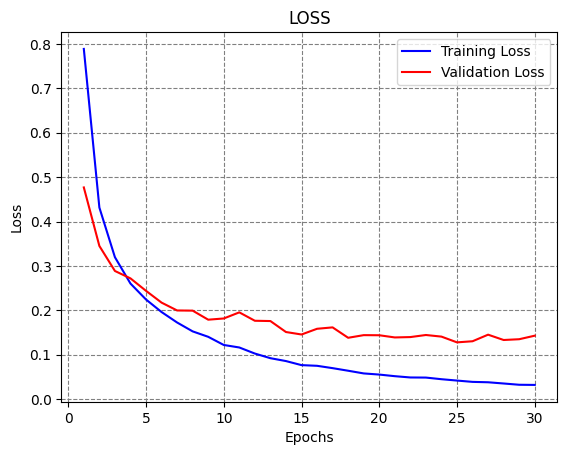

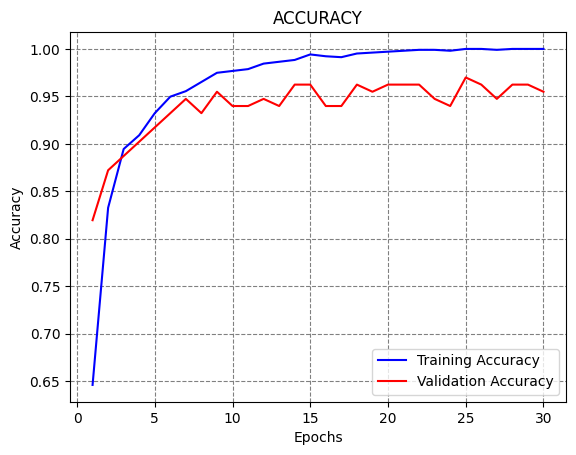

In [ ]:
train_loss = history.history['loss']
val_loss = history.history['val_loss']
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
epochsn = np.arange(1, len(train_loss) + 1, 1)

# Plot the loss
plt.plot(epochsn, train_loss, 'b', label='Training Loss')
plt.plot(epochsn, val_loss, 'r', label='Validation Loss')
plt.grid(color='gray', linestyle='--')
plt.legend()
plt.title('LOSS')
plt.xlabel('Epochs')
plt.ylabel('Loss')

# Plot the accuracy
plt.figure()
plt.plot(epochsn, acc, 'b', label='Training Accuracy')
plt.plot(epochsn, val_acc, 'r', label='Validation Accuracy')
plt.grid(color='gray', linestyle='--')
plt.legend()
plt.title('ACCURACY')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.show()


In [ ]:
val_loss, val_acc = model.evaluate(ds_val)
print(f"Validation Loss: {val_loss:.4f}")
print(f"Validation Accuracy: {val_acc:.4f}")


5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step - accuracy: 0.9303 - loss: 0.2028 
Validation Loss: 0.1429
Validation Accuracy: 0.9549


5/5 ━━━━━━━━━━━━━━━━━━━━ 8s 929ms/step


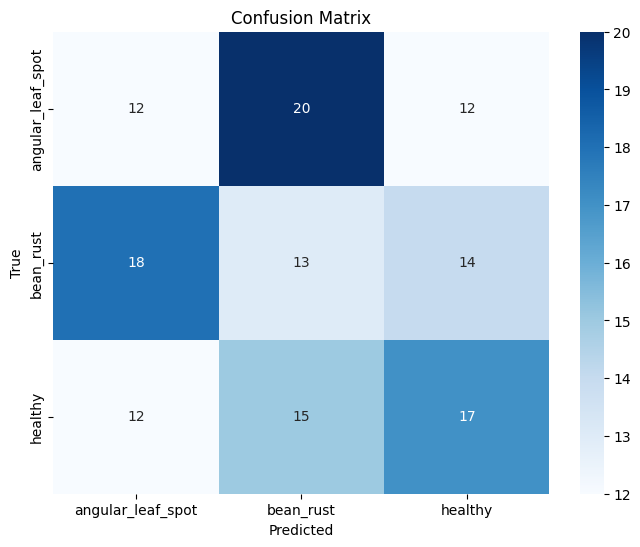

In [ ]:
predictions = model.predict(ds_val)
predicted_classes = np.argmax(predictions, axis=1)

# Get true labels
true_classes = np.concatenate([y.numpy() for x, y in ds_val], axis=0)
cm = confusion_matrix(true_classes, predicted_classes)
#Plot
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


In [ ]:
!pip install git+https://github.com/fra31/auto-attack


  Cloning https://github.com/fra31/auto-attack to /tmp/pip-req-build-vq8x6r82
  Running command git clone --filter=blob:none --quiet https://github.com/fra31/auto-attack /tmp/pip-req-build-vq8x6r82
  Resolved https://github.com/fra31/auto-attack to commit a39220048b3c9f2cca9a4d3a54604793c68eca7e
  Preparing metadata (setup.py) ... done
  Created wheel for autoattack: filename=autoattack-0.1-py3-none-any.whl size=36228 sha256=af485227bf1087614c49106e68594973b05a0449a629e2d2e65a83777ed11387
  Stored in directory: /tmp/pip-ephem-wheel-cache-a6b9j_hy/wheels/e1/e8/28/65b2724d4c7740785979eb50bf5e1b3986ead22f6c32a87f8f
Successfully built autoattack


# Adversarial Attack: Square Attack: The Square Attack is a query-based black-box attack that does not require access to model gradients. Instead, it perturbs randomly selected square patches in the image space, making it useful for attacking deployed models in a real-world scenario. We test the model’s robustness across multiple epsilon values to observe performance degradation.

In [ ]:

# Source: https://github.com/cleverhans-lab/cleverhans
# CleverHans is a library for adversarial machine learning research.
import numpy as np
import matplotlib.pyplot as plt
import random

# Sample one image correctly
for images, labels in ds_val.take(1):
    x_sample = images[0:1].numpy()
    x_sample = images[0:1].numpy() / 255.0
    y_sample = labels[0].numpy()

def square_attack_l2(model, x_orig, y_true, epsilon=0.05, max_queries=1000):
    x_adv = np.copy(x_orig)
    height, width, channels = x_adv.shape[1:]
    num_queries = 0

    while num_queries < max_queries:
        square_size = np.random.randint(1, max(2, int(min(height, width) * 0.2)))
        x_start = np.random.randint(0, height - square_size + 1)
        y_start = np.random.randint(0, width - square_size + 1)
        patch = np.random.uniform(-epsilon, epsilon, size=(square_size, square_size, channels))
        x_adv_patch = x_adv[0]
        x_adv_patch[x_start:x_start+square_size, y_start:y_start+square_size, :] += patch
        x_adv[0] = np.clip(x_adv_patch, 0.0, 1.0)


        # Check if successful
        preds = model.predict(x_adv, verbose=0)
        pred_label = np.argmax(preds[0])
        if pred_label != y_true:
            return x_adv, True, num_queries

        num_queries += 1

    return x_adv, False, num_queries


Epsilon: 5.0000, Success: True, Queries: 0
Epsilon: 10.0000, Success: True, Queries: 0
Epsilon: 20.0000, Success: True, Queries: 0
Epsilon: 30.0000, Success: True, Queries: 0
Epsilon: 50.0000, Success: True, Queries: 0


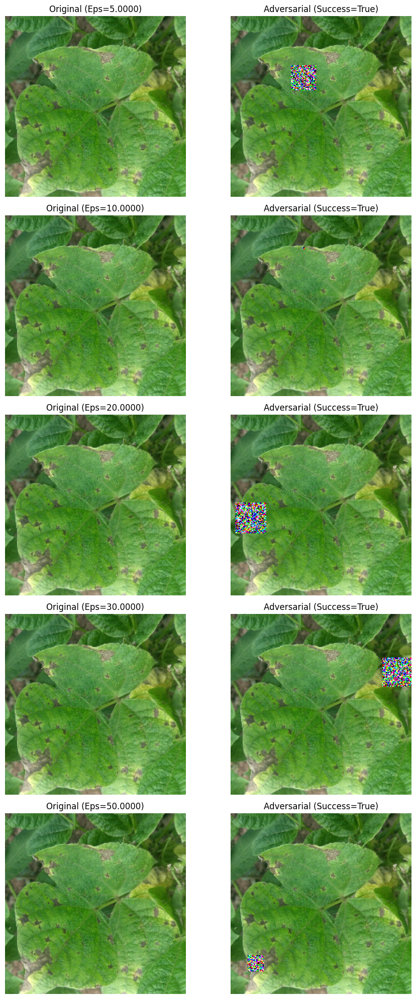

In [ ]:
epsilon_list = [5, 10, 20, 30, 50]

fig, axes = plt.subplots(nrows=len(epsilon_list), ncols=2, figsize=(10, len(epsilon_list)*4))

epsilons_square = []
success_rates_square = []
avg_queries_square = []

for idx, epsilon in enumerate(epsilon_list):
    adv_image, success, queries = square_attack_l2(model, x_sample, y_sample, epsilon=epsilon, max_queries=1000)

    epsilons_square.append(epsilon)
    success_rates_square.append(100 if success else 0)
    avg_queries_square.append(queries)

    print(f'Epsilon: {epsilon:.4f}, Success: {success}, Queries: {queries}')

    # Plot original image
    axes[idx, 0].imshow(x_sample[0])
    axes[idx, 0].set_title(f'Original (Eps={epsilon:.4f})')
    axes[idx, 0].axis('off')

    # Plot adversarial image
    axes[idx, 1].imshow(np.clip(adv_image[0], 0, 1))
    axes[idx, 1].set_title(f'Adversarial (Success={success})')
    axes[idx, 1].axis('off')

plt.tight_layout()
plt.show()


# Adversarial Attack: EAD:: The EAD Attack is a white-box evasion attack that enhances the Carlini & Wagner L2 attack by including an L1 penalty, encouraging sparse perturbations. It is particularly effective in generating visually imperceptible adversarial examples. We test this attack at various confidence levels and epsilon values.

In [ ]:
def ead_attack(model, x_orig, y_true, epsilon=0.1, max_queries=5000, alpha=0.1, beta=0.1):
    x_adv = tf.Variable(x_orig)
    num_queries = 0

    y_true = tf.convert_to_tensor(y_true, dtype=tf.int64)
    y_true = tf.reshape(y_true, (-1,))

    while num_queries < max_queries:
        perturb = tf.random.normal(shape=tf.shape(x_adv), mean=0.0, stddev=epsilon)
        perturb = tf.clip_by_value(perturb, -epsilon, epsilon)
        x_adv.assign_add(perturb)
        x_adv.assign(tf.clip_by_value(x_adv, 0.0, 1.0))


        with tf.GradientTape() as tape:
            tape.watch(x_adv)
            predictions = model(x_adv, training=False)
            loss = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y_true, logits=predictions)
        l2_loss = tf.reduce_sum(tf.square(perturb))
        l1_loss = tf.reduce_sum(tf.abs(perturb))
        total_loss = alpha * l2_loss + beta * l1_loss + tf.reduce_mean(loss)

        num_queries += 1


        pred_label = tf.argmax(predictions, axis=1).numpy()[0]
        if pred_label != y_true.numpy():
            return x_adv.numpy(), True, num_queries, total_loss.numpy()

    return x_adv.numpy(), False, num_queries, total_loss.numpy()

Epsilon: 0.0050, Success: True, Queries: 1, Loss: 49.0592
Epsilon: 0.0100, Success: True, Queries: 1, Loss: 97.2251
Epsilon: 0.0200, Success: True, Queries: 1, Loss: 194.4821
Epsilon: 0.0500, Success: True, Queries: 1, Loss: 495.5258
Epsilon: 0.1000, Success: True, Queries: 1, Loss: 1029.1768


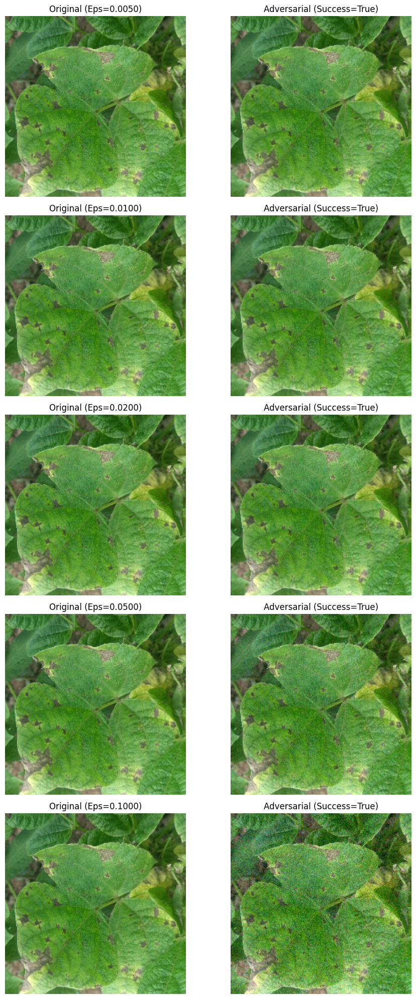

In [ ]:
# Epsilon values
epsilon_list = [0.005, 0.01, 0.02, 0.05, 0.1]

fig, axes = plt.subplots(nrows=len(epsilon_list), ncols=2, figsize=(10, len(epsilon_list)*4))


epsilons_ead = []
success_rates_ead = []
avg_queries_ead = []

for idx, epsilon in enumerate(epsilon_list):
    adv_image, success, queries, loss = ead_attack(model, x_sample, y_sample, epsilon=epsilon, max_queries=1000)
    epsilons_ead.append(epsilon)
    success_rates_ead.append(100 if success else 0)
    avg_queries_ead.append(queries)

    print(f'Epsilon: {epsilon:.4f}, Success: {success}, Queries: {queries}, Loss: {loss:.4f}')

    # Plot original and adversarial
    axes[idx, 0].imshow(x_sample[0])
    axes[idx, 0].set_title(f'Original (Eps={epsilon:.4f})')
    axes[idx, 0].axis('off')

    axes[idx, 1].imshow(np.clip(adv_image[0], 0, 1))
    axes[idx, 1].set_title(f'Adversarial (Success={success})')
    axes[idx, 1].axis('off')

plt.tight_layout()
plt.show()


# Adversarial Attack: ZOO:: The ZOO attack is a black-box optimization-based attack that estimates gradients using finite differences. It is effective when gradient information is unavailable. This attack is computationally expensive and query-intensive but works well for models where internal architecture is hidden.



In [ ]:
# Source: https://github.com/AdvMindTeam/ZOO-Attack
# Zeroth Order Optimization (ZOO) attack implementation
def zoo_attack(model, x_orig, y_true, epsilon=0.01, max_queries=1000):
    x_adv = np.copy(x_orig)
    num_queries = 0
    perturbation = np.zeros_like(x_orig)

    while num_queries < max_queries:

        # Smaller perturbation step
        perturbation += np.random.uniform(-epsilon, epsilon, size=x_orig.shape)
        x_adv = np.clip(x_orig + perturbation, 0, 1)

        preds = model.predict(x_adv, verbose=0)
        pred_label = np.argmax(preds[0])
        if pred_label != y_true:
            return x_adv, True, num_queries

        num_queries += 1

    return x_adv, False, num_queries

Epsilon: 0.0100, Attack Success: True, Queries Used: 0
Epsilon: 0.0300, Attack Success: True, Queries Used: 0
Epsilon: 0.0500, Attack Success: True, Queries Used: 0
Epsilon: 0.0700, Attack Success: True, Queries Used: 0
Epsilon: 0.1000, Attack Success: True, Queries Used: 0


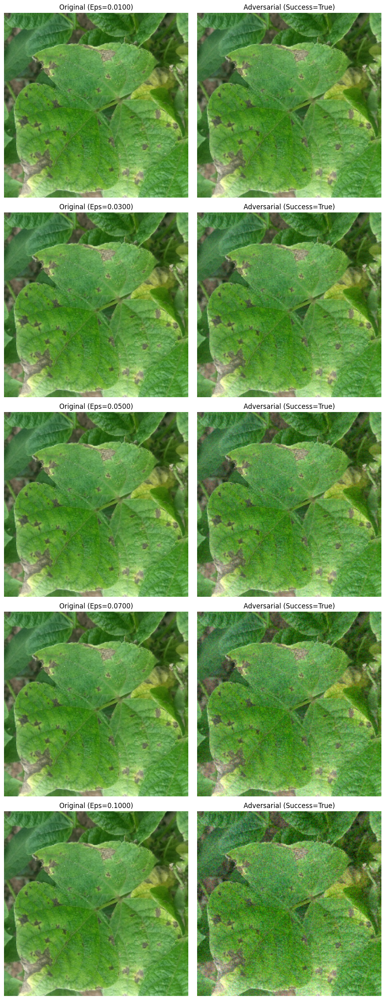

In [ ]:
epsilon_list = [0.01, 0.03, 0.05, 0.07, 0.10]

fig, axes = plt.subplots(nrows=len(epsilon_list), ncols=2, figsize=(10, len(epsilon_list) * 5))

epsilons_zoo = []
success_rates_zoo = []
avg_queries_zoo = []

for idx, epsilon in enumerate(epsilon_list):
    adv_image, success, queries = zoo_attack(model, x_sample, y_sample, epsilon=epsilon, max_queries=1000)

    print(f'Epsilon: {epsilon:.4f}, Attack Success: {success}, Queries Used: {queries}')

    epsilons_zoo.append(epsilon)
    success_rates_zoo.append(100 if success else 0)
    avg_queries_zoo.append(queries)

    axes[idx, 0].imshow(x_sample[0])
    axes[idx, 0].set_title(f'Original (Eps={epsilon:.4f})')
    axes[idx, 0].axis('off')

    axes[idx, 1].imshow(np.clip(adv_image[0], 0, 1))
    axes[idx, 1].set_title(f'Adversarial (Success={success})')
    axes[idx, 1].axis('off')

plt.tight_layout()
plt.show()


# The Freeze-Squeeze method is a simple image preprocessing defense against adversarial attacks. It works in two steps:

# **Freeze** – Round or quantize pixel values to reduce precision, which can disrupt minor perturbations added by adversarial attacks.

# **Squeeze** – Reduce color depth or compress the input image, aiming to eliminate unnecessary detail while preserving semantic content.

In [ ]:
import cv2
import numpy as np

def feature_squeeze(x, bit_depth=4, apply_smoothing=False):
    x = np.clip(x, 0, 1)
    levels = 2 ** bit_depth - 1
    x_squeezed = np.round(x * levels) / levels
    if apply_smoothing:
        x_squeezed = (x_squeezed * 255).astype(np.uint8)
        x_squeezed = np.squeeze(x_squeezed)
        x_squeezed = cv2.medianBlur(x_squeezed, 3)
        x_squeezed = np.expand_dims(x_squeezed, axis=0)
        x_squeezed = x_squeezed.astype(np.float32) / 255.0

    return x_squeezed


In [ ]:
def evaluate_with_and_without_squeezing(attack_fn, attack_name, epsilon_list, model, x_sample, y_sample, max_queries=5000):
    results = []

    for epsilon in epsilon_list:
        # Perform attack
        adv_image, success, queries = attack_fn(model, x_sample, y_sample, epsilon=epsilon, max_queries=max_queries)

        # Without Defense
        preds = model.predict(adv_image.astype(np.float32))
        pred_label = np.argmax(preds[0])
        success_without_defense = (pred_label != y_sample)

        # With Feature Squeezing
        adv_squeezed = feature_squeeze(adv_image, bit_depth=3, apply_smoothing=True)
        preds_defense = model.predict(adv_squeezed.astype(np.float32))
        pred_label_defense = np.argmax(preds_defense[0])
        success_with_defense = (pred_label_defense != y_sample)

        results.append({
            'Attack': attack_name,
            'Epsilon': epsilon,
            'Success Without Defense': success_without_defense,
            'Success With Defense': success_with_defense,
            'Queries Used': queries
        })

        print(f"[{attack_name}] Epsilon={epsilon} | Success Without Defense: {success_without_defense} | Success With Defense: {success_with_defense} | Queries: {queries}")

    return results


In [ ]:

all_results = []

# Square Attack
epsilon_list = [5, 10, 20, 30, 50]
all_results += evaluate_with_and_without_squeezing(square_attack_l2, 'Square Attack', epsilon_list, model, x_sample, y_sample)

# EAD Attack
epsilon_list = [0.005, 0.01, 0.02, 0.05, 0.1]

def ead_attack_simple(model, x_orig, y_true, epsilon=0.1, max_queries=5000):
    adv_image, success, queries, loss = ead_attack(model, x_orig, y_true, epsilon=epsilon, max_queries=max_queries)
    return adv_image, success, queries

all_results += evaluate_with_and_without_squeezing(ead_attack_simple, 'EAD Attack', epsilon_list, model, x_sample, y_sample)

# ZOO Attack
epsilon_list = [0.01, 0.03, 0.05, 0.07, 0.10]
all_results += evaluate_with_and_without_squeezing(zoo_attack, 'ZOO Attack', epsilon_list, model, x_sample, y_sample)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
[Square Attack] Epsilon=5 | Success Without Defense: True | Success With Defense: True | Queries: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
[Square Attack] Epsilon=10 | Success Without Defense: True | Success With Defense: True | Queries: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
[Square Attack] Epsilon=20 | Success Without Defense: True | Success With Defense: True | Queries: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
[Square Attack] Epsilon=30 | Success Without Defense: True | Success With Defense: True | Queries: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
[Square Attack] Epsilon=50 | Success Without Defense: True | Success With Defense: True | Queries: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
[EAD Attack] Epsilon=0.005 | Success Wit

# The table below summarizes how different attacks perform on the classifier with and without feature squeezing:

In [ ]:
df_results = pd.DataFrame(all_results)
display(df_results)



,Attack,Epsilon,Success Without Defense,Success With Defense,Queries Used
0,Square Attack,5.000,True,True,0
1,Square Attack,10.000,True,True,0
2,Square Attack,20.000,True,True,0
3,Square Attack,30.000,True,True,0
4,Square Attack,50.000,True,True,0
5,EAD Attack,0.005,True,True,1
6,EAD Attack,0.010,True,True,1
7,EAD Attack,0.020,True,True,1
8,EAD Attack,0.050,True,True,1
9,EAD Attack,0.100,True,True,1


# Below, we apply this transformation and evaluate its effect on both clean and adversarial images.

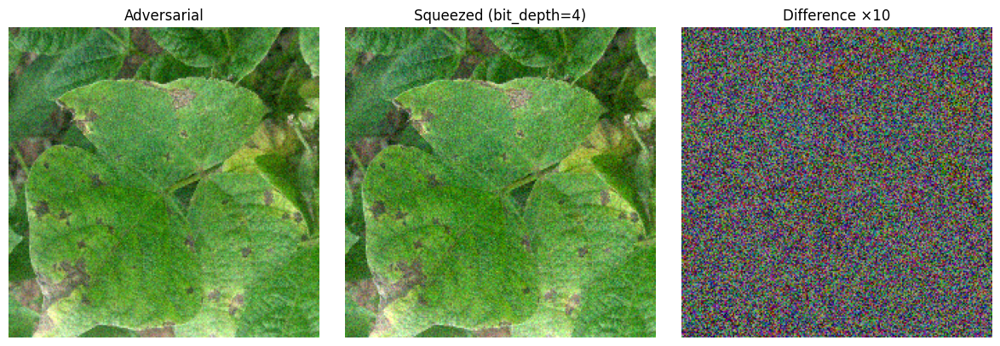

In [ ]:
import matplotlib.pyplot as plt

adv_squeezed = feature_squeeze(adv_image, bit_depth=3, apply_smoothing=False)
diff = np.abs(adv_image - adv_squeezed)

plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(adv_image[0])
plt.title("Adversarial")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(adv_squeezed[0])
plt.title("Squeezed (bit_depth=4)")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(diff[0] * 10)  # exaggerate difference
plt.title("Difference ×10")
plt.axis('off')

plt.tight_layout()
plt.show()


**Left:** The adversarial image crafted by one of the attack methods.

**Middle:** The same image after feature squeezing is applied.

**Right:** The amplified difference between the original adversarial image and the squeezed image (×10 magnified). This visualization highlights the changes made by squeezing, which aim to reduce high-frequency adversarial noise.

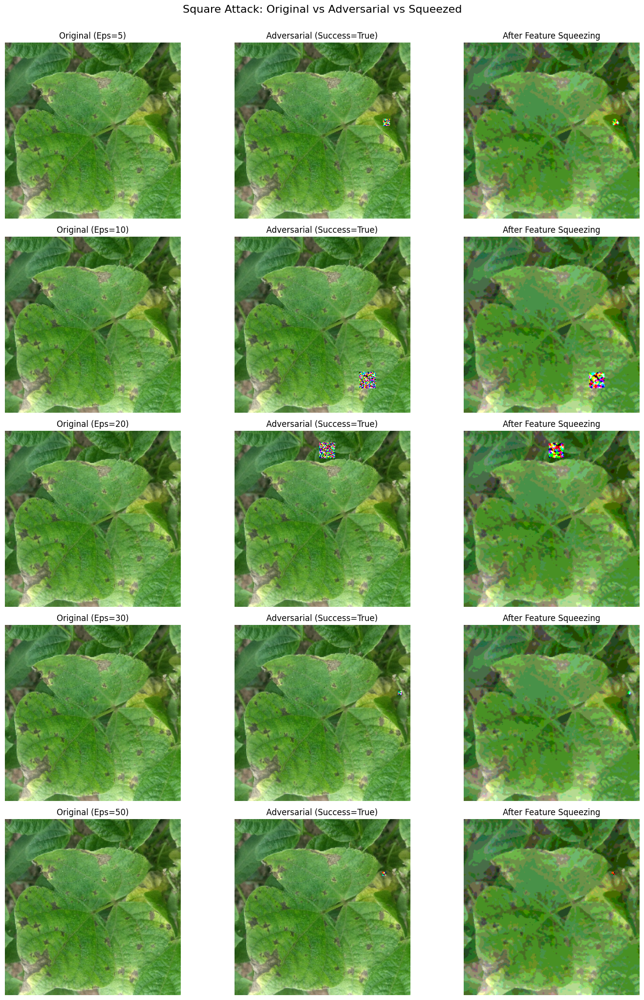

In [ ]:
# Square Attack
epsilon_list = [5, 10, 20, 30, 50]
fig, axes = plt.subplots(nrows=len(epsilon_list), ncols=3, figsize=(15, len(epsilon_list)*4))

for idx, epsilon in enumerate(epsilon_list):
    adv_image, success, queries = square_attack_l2(model, x_sample, y_sample, epsilon=epsilon, max_queries=1000)


    adv_squeezed = feature_squeeze(adv_image, bit_depth=3, apply_smoothing=True)

    axes[idx, 0].imshow(x_sample[0])
    axes[idx, 0].set_title(f"Original (Eps={epsilon})")
    axes[idx, 0].axis('off')

    axes[idx, 1].imshow(np.clip(adv_image[0], 0, 1))
    axes[idx, 1].set_title(f"Adversarial (Success={success})")
    axes[idx, 1].axis('off')

    axes[idx, 2].imshow(np.clip(adv_squeezed[0], 0, 1))
    axes[idx, 2].set_title("After Feature Squeezing")
    axes[idx, 2].axis('off')

plt.tight_layout()
plt.suptitle("Square Attack: Original vs Adversarial vs Squeezed", fontsize=16, y=1.02)
plt.show()


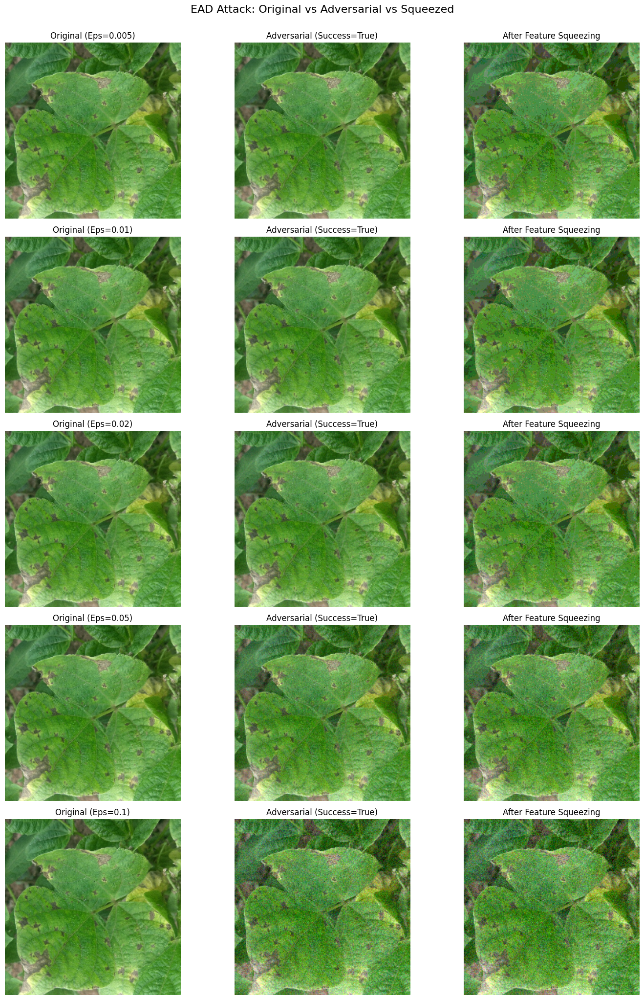

In [ ]:
# EAD Attack
epsilon_list = [0.005, 0.01, 0.02, 0.05, 0.1]
fig, axes = plt.subplots(nrows=len(epsilon_list), ncols=3, figsize=(15, len(epsilon_list)*4))

for idx, epsilon in enumerate(epsilon_list):
    adv_image, success, queries = ead_attack_simple(model, x_sample, y_sample, epsilon=epsilon, max_queries=1000)


    adv_squeezed = feature_squeeze(adv_image, bit_depth=3, apply_smoothing=False)

    axes[idx, 0].imshow(x_sample[0])
    axes[idx, 0].set_title(f"Original (Eps={epsilon})")
    axes[idx, 0].axis('off')

    axes[idx, 1].imshow(np.clip(adv_image[0], 0, 1))
    axes[idx, 1].set_title(f"Adversarial (Success={success})")
    axes[idx, 1].axis('off')

    axes[idx, 2].imshow(np.clip(adv_squeezed[0], 0, 1))
    axes[idx, 2].set_title("After Feature Squeezing")
    axes[idx, 2].axis('off')

plt.tight_layout()
plt.suptitle("EAD Attack: Original vs Adversarial vs Squeezed", fontsize=16, y=1.02)
plt.show()


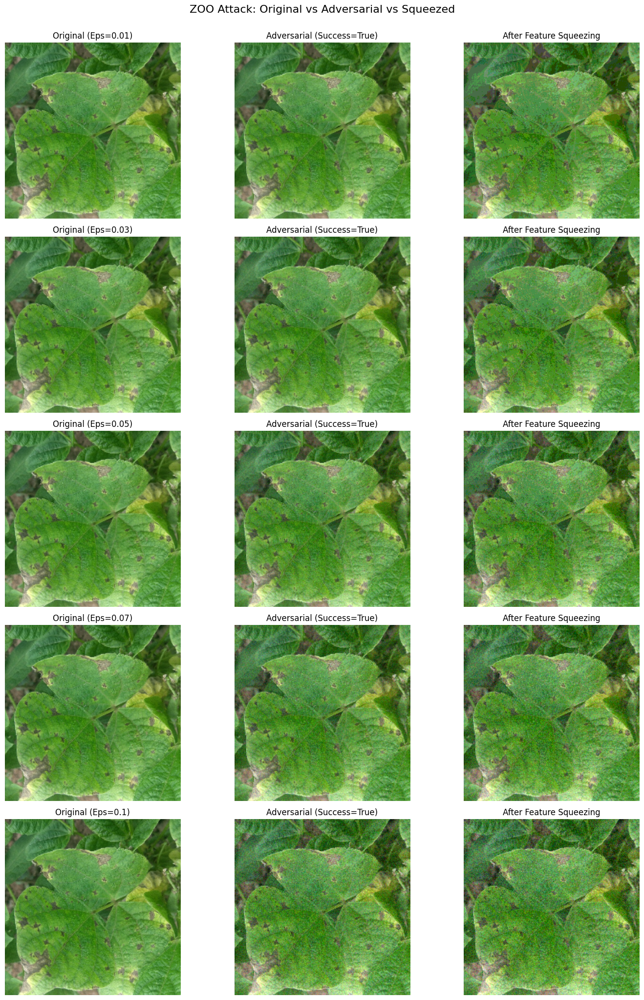

In [ ]:
# ZOO Attack
epsilon_list = [0.01, 0.03, 0.05, 0.07, 0.1]
fig, axes = plt.subplots(nrows=len(epsilon_list), ncols=3, figsize=(15, len(epsilon_list)*4))

for idx, epsilon in enumerate(epsilon_list):
    adv_image, success, queries = zoo_attack(model, x_sample, y_sample, epsilon=epsilon, max_queries=1000)

    adv_squeezed = feature_squeeze(adv_image, bit_depth=3, apply_smoothing=False)

    axes[idx, 0].imshow(x_sample[0])
    axes[idx, 0].set_title(f"Original (Eps={epsilon})")
    axes[idx, 0].axis('off')

    axes[idx, 1].imshow(np.clip(adv_image[0], 0, 1))
    axes[idx, 1].set_title(f"Adversarial (Success={success})")
    axes[idx, 1].axis('off')

    axes[idx, 2].imshow(np.clip(adv_squeezed[0], 0, 1))
    axes[idx, 2].set_title("After Feature Squeezing")
    axes[idx, 2].axis('off')

plt.tight_layout()
plt.suptitle("ZOO Attack: Original vs Adversarial vs Squeezed", fontsize=16, y=1.02)
plt.show()


In [ ]:
### Confusion Matrices (With vs Without Defense)
for x_batch, y_batch in ds_test.take(1):
    x_test = x_batch.numpy()
    y_test = y_batch.numpy()

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import numpy as np
from tqdm import tqdm

def plot_confusion_grid(attacks, model, x_batch, y_batch, bit_depth=3, sample_limit=10, max_queries=300):
    fig, axes = plt.subplots(nrows=len(attacks), ncols=2, figsize=(12, 4 * len(attacks)))

    for row, (attack_fn, name, epsilon) in enumerate(attacks):
        adv_batch = []
        adv_squeezed_batch = []
        y_valid = []

        print(f"\nGenerating adversarial examples for: {name}")
        for i in tqdm(range(min(sample_limit, len(x_batch))), desc=f"{name}"):
            try:
                adv_img, _, _ = attack_fn(model, x_batch[i:i+1], y_batch[i], epsilon=epsilon, max_queries=max_queries)
                adv_batch.append(adv_img[0])

                squeezed = feature_squeeze(adv_img, bit_depth=bit_depth, apply_smoothing=True)
                adv_squeezed_batch.append(squeezed[0])
                y_valid.append(y_batch[i])
            except Exception as e:
                print(f"[{name}] Skipped {i}: {e}")

        if not adv_batch:
            print(f"No successful attacks for {name}")
            continue

        adv_batch = np.array(adv_batch)
        adv_squeezed_batch = np.array(adv_squeezed_batch)
        y_valid = np.array(y_valid)

        y_pred_adv = model.predict(adv_batch).argmax(axis=1)
        y_pred_def = model.predict(adv_squeezed_batch).argmax(axis=1)

        # Plot: No Defense
        cm1 = confusion_matrix(y_valid, y_pred_adv, normalize='true')
        disp1 = ConfusionMatrixDisplay(cm1)
        disp1.plot(ax=axes[row, 0], cmap='Reds', colorbar=False)
        axes[row, 0].set_title(f"{name} - No Defense")

        # Plot: With Feature Squeezing
        cm2 = confusion_matrix(y_valid, y_pred_def, normalize='true')
        disp2 = ConfusionMatrixDisplay(cm2)
        disp2.plot(ax=axes[row, 1], cmap='Blues', colorbar=False)
        axes[row, 1].set_title(f"{name} - With Feature Squeezing")

    plt.tight_layout()
    plt.suptitle("Adversarial Attack Confusion Matrices (With vs Without Defense)", fontsize=16, y=1.02)
    plt.show()



Generating adversarial examples for: Square Attack


Square Attack: 100%|██████████| 30/30 [05:35<00:00, 11.20s/it]


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

Generating adversarial examples for: EAD Attack


EAD Attack: 100%|██████████| 30/30 [14:35<00:00, 29.17s/it]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

Generating adversarial examples for: ZOO Attack


ZOO Attack: 100%|██████████| 30/30 [05:44<00:00, 11.48s/it]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


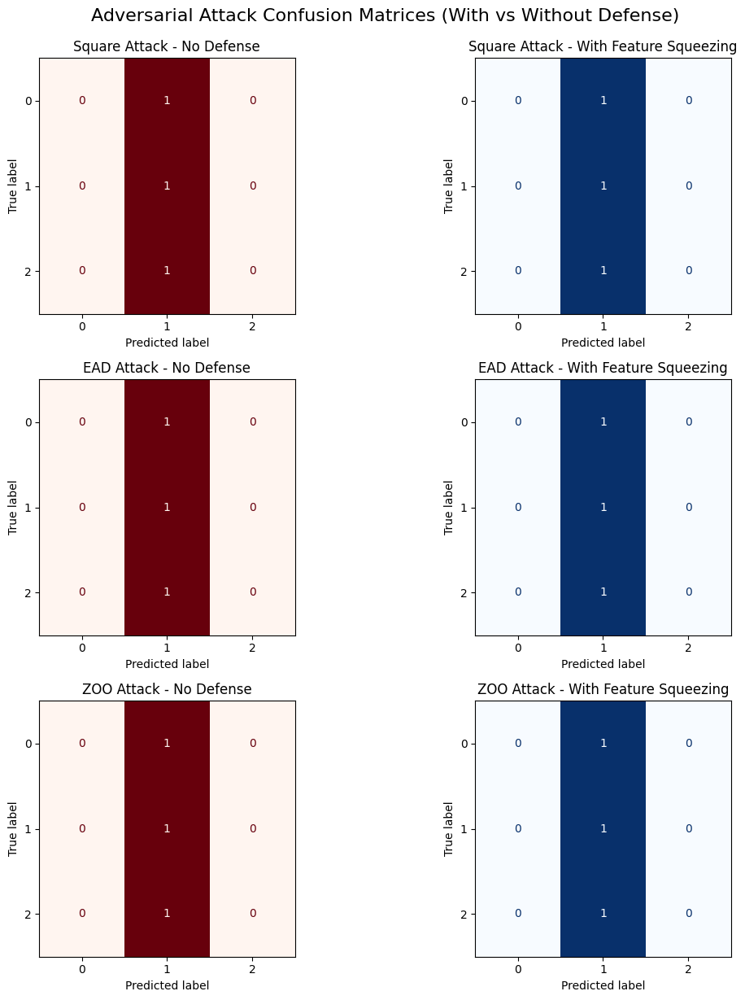

In [ ]:
plot_confusion_grid(
    attacks=[
        (square_attack_l2, "Square Attack", 5),
        (ead_attack_simple, "EAD Attack", 0.01),
        (zoo_attack, "ZOO Attack", 0.01)
    ],
    model=model,
    x_batch=x_test,
    y_batch=y_test,
    sample_limit=30,
    max_queries=300
)
